# Unit 5 - Financial Planning


In [6]:
# Initial imports
import os
import requests
import pandas as pd
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation

%matplotlib inline

In [7]:
# Load .env enviroment variables
load_dotenv()

True

## Part 1 - Personal Finance Planner

### Collect Crypto Prices Using the `requests` Library

In [8]:
# Set current amount of crypto assets
my_btc = 1.2
my_eth = 5.3

In [9]:
# Crypto API URLs
btc_url = "https://api.alternative.me/v2/ticker/Bitcoin/?convert=USD"
eth_url = "https://api.alternative.me/v2/ticker/Ethereum/?convert=USD"

In [10]:
# Fetch current BTC price
btc_response_data = requests.get(btc_url)

# Fetch current ETH price
eth_response_data = requests.get(eth_url)

# Compute current value of my crpto
import json
btc_data = btc_response_data.json()
my_btc_value = my_btc * btc_data['data']['1']['quotes']['USD']['price']

eth_data = eth_response_data.json()
my_eth_value = my_eth * eth_data['data']['1027']['quotes']['USD']['price']

# Print current crypto wallet balance
print(f"The current value of your {my_btc} BTC is ${my_btc_value:0.2f}")
print(f"The current value of your {my_eth} ETH is ${my_eth_value:0.2f}")

The current value of your 1.2 BTC is $13771.06
The current value of your 5.3 ETH is $2034.62


### Collect Investments Data Using Alpaca: `SPY` (stocks) and `AGG` (bonds)

In [11]:
# Current amount of shares
my_agg = 200
my_spy = 50


In [12]:
# Set Alpaca API key and secret
alpaca_api_key = os.getenv("APCA_API_KEY_ID")
alpaca_secret_key = os.getenv("APCA_SECRET_KEY")

# Create the Alpaca API object
api = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version = "v2"
)


In [13]:
# Format current date as ISO format
start_date = pd.Timestamp("2020-10-12", tz="America/New_York").isoformat()

# Set the tickers
tickers = ["AGG", "SPY"]

# Set timeframe to '1D' for Alpaca API
timeframe = "1D"

# Get current closing prices for SPY and AGG
ticker_data = api.get_barset(
    tickers,
    timeframe,
    start=start_date
).df

# Preview DataFrame
ticker_data.head()


AGG                                      SPY  \
                             open    high     low   close   volume    open   
time                                                                         
2020-10-12 00:00:00-04:00  117.85  117.94  117.77  117.93  2770157  349.59   

                                                             
                             high     low   close    volume  
time                                                         
2020-10-12 00:00:00-04:00  354.02  349.06  352.43  61163344

In [14]:
# Pick AGG and SPY close prices
agg_close_price = ticker_data['AGG']['close']['2020-10-12']
spy_close_price = ticker_data['SPY']['close']['2020-10-12']

# Print AGG and SPY close prices
print(f"Current AGG closing price: ${agg_close_price}")
print(f"Current SPY closing price: ${spy_close_price}")

Current AGG closing price: $117.93
Current SPY closing price: $352.43


In [15]:
# Compute the current value of shares
my_agg_value = my_agg * agg_close_price
my_spy_value = my_spy * spy_close_price

# Print current value of share
print(f"The current value of your {my_spy} SPY shares is ${my_spy_value:0.2f}")
print(f"The current value of your {my_agg} AGG shares is ${my_agg_value:0.2f}")

The current value of your 50 SPY shares is $17621.50
The current value of your 200 AGG shares is $23586.00


### Savings Health Analysis

In [16]:
# Set monthly household income
monthly_income = 12000

# Create savings DataFrame
crypto_value = my_btc_value + my_eth_value
shares_value = my_spy_value + my_agg_value
df = {'amount' : {
        "crypto" : crypto_value,
        "shares" : shares_value
        }
    }
df_savings = pd.DataFrame(df)

# Display savings DataFrame
display(df_savings)

,amount
crypto,15805.673
shares,41207.500


## Part 2 - Retirement Planning

### Monte Carlo Simulation

In [17]:
# Set start and end dates of five years back from today.
# Sample results may vary from the solution based on the time frame chosen
start_date = pd.Timestamp('2015-08-07', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2020-08-07', tz='America/New_York').isoformat()

In [18]:
# Get 5 years' worth of historical data for SPY and AGG
df_stock_data = api.get_barset(
    tickers,
    timeframe,
    start=start_date,
    end=end_date
).df

# Display sample data
df_stock_data.head()

AGG                                         SPY  \
                             open      high      low   close   volume    open   
time                                                                            
2015-08-07 00:00:00-04:00  109.14  109.2750  109.035  109.21  2041167  208.16   
2015-08-10 00:00:00-04:00  109.15  109.1700  108.920  109.06  1149778  209.28   
2015-08-11 00:00:00-04:00  109.42  109.5765  109.284  109.42  1420907  208.98   
2015-08-12 00:00:00-04:00  109.55  109.7100  109.350  109.36  1468979  207.11   
2015-08-13 00:00:00-04:00  109.36  109.3651  109.110  109.15  1465173  208.73   

                                                              
                             high     low   close     volume  
time                                                          
2015-08-07 00:00:00-04:00  208.34  206.87  207.93   87669782  
2015-08-10 00:00:00-04:00  210.67  209.28  210.58   66755890  
2015-08-11 00:00:00-04:00  209.47  207.76  208.63   88424557  
2015-08-12 00:00:00-04:00  209.14  205.36  208.89  136171450  
2015-08-13 00:00:00-04:00  209.55  208.01  208.63   77197796

## Optional Challenge - Early Retirement


### Five Years Retirement Option

In [19]:
# Configuring a Monte Carlo simulation to forecast 5 years cumulative returns
MC_even_dist = MCSimulation(
    portfolio_data = df_stock_data,
    weights = [.6,.4],
    num_simulation = 500,
    num_trading_days = 252 * 5
)


In [20]:
# Running a Monte Carlo simulation to forecast 5 years cumulative returns
MC_even_dist.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.994731,0.998528,1.006029,1.002281,1.001193,0.999801,0.995968,1.006897,1.003530,0.998082,...,0.995376,1.000627,1.001410,1.006572,0.995468,0.998030,0.999305,1.006330,0.998720,1.003252
2,1.001702,1.006146,1.007987,0.994093,0.990403,1.001418,1.007005,1.004935,1.007131,0.992758,...,0.996993,0.994138,1.002970,1.012966,0.995147,1.009031,1.003490,1.007781,1.009436,1.004486
3,1.001653,1.009910,1.004420,0.990368,0.995008,0.997059,1.007117,1.006068,1.004702,0.994736,...,0.992538,0.996036,1.008770,1.010208,0.990064,1.004274,0.999136,1.017105,1.018226,1.002499
4,1.002298,1.013662,0.996010,0.989965,1.000712,1.003119,1.009015,0.999949,1.009652,0.988467,...,0.999126,0.998672,1.012579,1.003690,0.992168,1.003813,0.995219,1.007325,1.019860,1.004307
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1256,1.428688,1.559021,1.098729,1.394173,1.246495,1.604305,1.381347,1.353990,1.162821,1.763384,...,1.129501,1.001047,1.328261,1.353677,1.696137,1.342978,1.053009,1.489926,1.040236,1.119143
1257,1.432128,1.549540,1.096606,1.403005,1.241093,1.600238,1.385262,1.361572,1.157821,1.780066,...,1.138038,1.004120,1.326586,1.355927,1.687428,1.339537,1.048816,1.500299,1.039865,1.121748
1258,1.434062,1.538973,1.102067,1.398725,1.247517,1.600032,1.384302,1.356541,1.150626,1.773755,...,1.142953,0.997882,1.320641,1.369533,1.688509,1.340024,1.051299,1.506901,1.042673,1.121052
1259,1.442657,1.542052,1.102523,1.404230,1.248025,1.606333,1.389419,1.356292,1.148676,1.771582,...,1.140854,0.994546,1.307087,1.365551,1.684170,1.330751,1.049558,1.510048,1.040013,1.117947


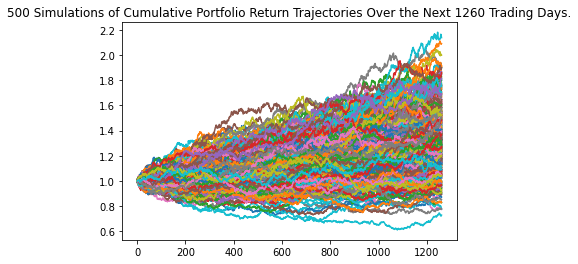

In [21]:
# Plot simulation outcomes
line_plot = MC_even_dist.plot_simulation()

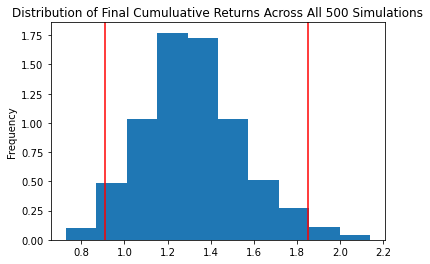

In [22]:
# Plot probability distribution and confidence intervals
dist_plot = MC_even_dist.plot_distribution()

In [23]:
# Fetch summary statistics from the Monte Carlo simulation results
even_tbl = MC_even_dist.summarize_cumulative_return()

# Print summary statistics
print(even_tbl)

count           500.000000
mean              1.320450
std               0.232390
min               0.728320
25%               1.160012
50%               1.310189
75%               1.467865
max               2.139703
95% CI Lower      0.908702
95% CI Upper      1.851367
Name: 1260, dtype: float64


In [24]:
# Set initial investment
initial_investment = 60000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
ci_lower_five = round(even_tbl[8]*initial_investment,2)
ci_upper_five = round(even_tbl[9]*initial_investment,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 5 years will end within in the range of"
      f" ${ci_lower_five} and ${ci_upper_five}")

There is a 95% chance that an initial investment of $60000 in the portfolio over the next 5 years will end within in the range of $54522.13 and $111082.0


### Ten Years Retirement Option

In [25]:
# Configuring a Monte Carlo simulation to forecast 10 years cumulative returns
MC_even_dist = MCSimulation(
    portfolio_data = df_stock_data,
    weights = [.4,.6],
    num_simulation = 500,
    num_trading_days = 252 * 10
)

In [26]:
# Running a Monte Carlo simulation to forecast 10 years cumulative returns
MC_even_dist.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.999866,0.996957,0.988564,0.997159,1.005401,1.006801,1.003663,1.001011,1.000917,0.988878,...,1.000525,1.014686,1.000180,1.000007,1.000097,0.996380,0.996012,1.000032,0.986082,0.998751
2,0.999216,1.008367,0.977236,0.994208,1.012181,0.998941,1.012781,1.010321,0.998023,0.982394,...,0.991423,0.999528,0.987387,1.014984,1.009053,0.989481,0.979657,0.997664,0.978378,1.005707
3,0.999889,1.014337,0.966706,1.003292,1.025370,0.995016,1.021446,1.000242,0.995122,0.976334,...,0.988651,0.998008,0.987958,1.025066,1.010097,0.994291,0.986804,0.981994,0.976424,1.010324
4,1.000797,1.003230,0.961844,1.012137,1.030421,1.000287,1.013516,1.003787,1.012184,0.976634,...,1.001462,0.999899,0.986205,1.020615,1.014833,0.998613,0.993297,0.986799,0.981377,1.013869
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2516,2.261993,1.640840,1.880029,1.178937,2.202164,1.303780,1.287498,3.937848,3.324327,1.009836,...,3.244601,1.696514,1.293506,2.546772,1.668967,3.131001,0.668073,1.277460,2.240146,1.752928
2517,2.248627,1.640890,1.883808,1.159580,2.196822,1.303627,1.303912,3.942695,3.367098,1.008511,...,3.263131,1.675253,1.287561,2.568877,1.664623,3.125896,0.666373,1.285745,2.229176,1.766008
2518,2.250355,1.644793,1.884758,1.176359,2.190244,1.286146,1.316416,3.958262,3.387401,1.001478,...,3.277597,1.662387,1.281056,2.586345,1.677315,3.149351,0.666992,1.272078,2.221515,1.747284
2519,2.240515,1.657084,1.893799,1.184006,2.193832,1.289640,1.306848,3.961902,3.366305,1.006971,...,3.310461,1.638889,1.271000,2.597155,1.665013,3.128351,0.672721,1.268360,2.217832,1.747371


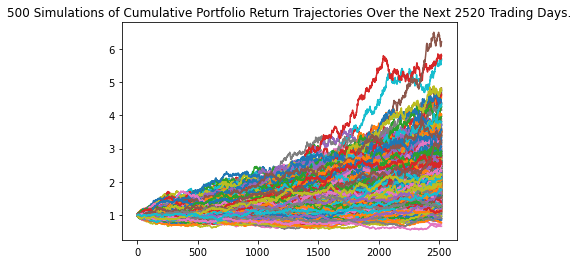

In [27]:
# Plot simulation outcomes
line_plot = MC_even_dist.plot_simulation()

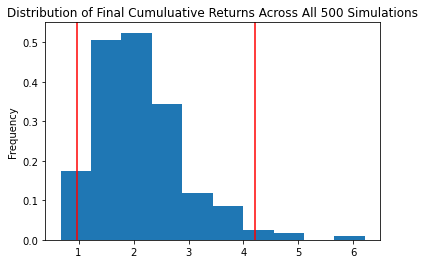

In [28]:
# Plot probability distribution and confidence intervals
dist_plot = MC_even_dist.plot_distribution()

In [29]:
# Fetch summary statistics from the Monte Carlo simulation results
even_tbl = MC_even_dist.summarize_cumulative_return()

# Print summary statistics
print(even_tbl)

count           500.000000
mean              2.138588
std               0.822939
min               0.672096
25%               1.545168
50%               2.041363
75%               2.533208
max               6.208080
95% CI Lower      0.979774
95% CI Upper      4.202027
Name: 2520, dtype: float64


In [30]:
# Set initial investment
initial_investment = 60000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
ci_lower_ten = round(even_tbl[8]*initial_investment,2)
ci_upper_ten = round(even_tbl[9]*initial_investment,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 10 years will end within in the range of"
      f" ${ci_lower_ten} and ${ci_upper_ten}")

There is a 95% chance that an initial investment of $60000 in the portfolio over the next 10 years will end within in the range of $58786.45 and $252121.63
